# Anders Li
# CID: 02458427

# Importing Basic Packages

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re
from tqdm import tqdm
tqdm.pandas()

# Sarcasm Detector

# Importing Data and Basic EDA

In [5]:
# Import sarcasm data
train = pd.read_csv("train-balanced.csv")
test = pd.read_csv("test-balanced.csv")

In [6]:
# Renaming sarcasm data columns
# columns = ['label', 'comment', 'author', 'subreddit', 'score', 'ups', 'downs', 'date', 'created_utc', 'parent_comment']
# train.columns = columns
# test.columns = columns

In [7]:
# Check for missing values
train.isna().sum()

label             0
comment           0
author            0
subreddit         0
score             0
ups               0
downs             0
date              0
created_utc       0
parent_comment    0
lengths           0
dtype: int64

In [121]:
# Drop nans if label, comment and parent_comment are missing
train.dropna(subset=['label', 'comment', 'parent_comment'], inplace=True)
test.dropna(subset=['label', 'comment', 'parent_comment'], inplace=True)

In [122]:
# Filter out subreddits
subreddit_finance = ['wallstreetbets', 'trading', 'crypto', 'stocks', 'investing', 'pennystocks']
subreddit_news = ['news', 'worldnews', 'politics', 'geopolitics', 'neutralpolitics', 'internationalpolitics']
subreddit = subreddit_finance + subreddit_news

In [123]:
subreddit_train = train[train['subreddit'].isin(subreddit)]
subreddit_test = test[test['subreddit'].isin(subreddit)]
X_train, y_train = subreddit_train[['comment', 'parent_comment']], subreddit_train['label']
X_test, y_test = subreddit_test[['comment', 'parent_comment']], subreddit_test['label']

In [ ]:
# Export filtered data to csv
# subreddit_train.to_csv('subreddit_train.csv', index=False)
# subreddit_test.to_csv('subreddit_test.csv', index=False)

Text(0.5, 1.0, 'Number of sarcastic and non-sarcastic \ncomments in the training set')

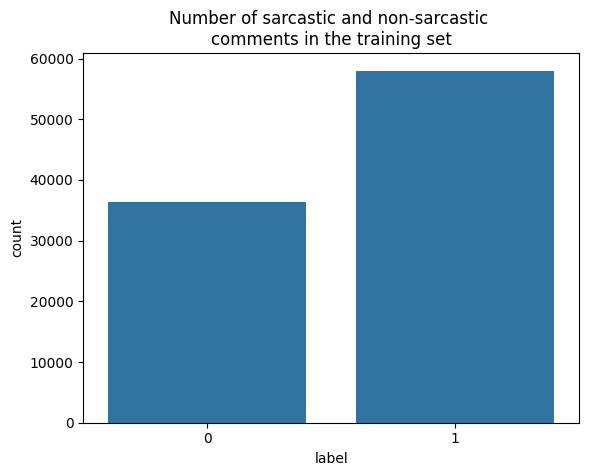

In [ ]:
# Plot number of sarcastic and non-sarcastic comments
sns.countplot(data=subreddit_train, x='label')
plt.title("Number of sarcastic and non-sarcastic \ncomments in the training set")

This refers to Figure 1 in the paper.

In [128]:
# Calculate the length of comments
subreddit_train["lengths"] = subreddit_train.progress_apply(lambda x: len((x['parent_comment'] + " " + x['comment']).split()), axis=1)
subreddit_train["lengths"] = subreddit_train.progress_apply(lambda x: len(x['comment'].split()), axis=1)
subreddit_train['lengths'].describe(percentiles=[.5, .75, .9, .95, .99])

  0%|          | 0/94313 [00:00<?, ?it/s]

100%|██████████| 94313/94313 [00:00<00:00, 113337.48it/s]
C:\Users\ander\AppData\Local\Temp\ipykernel_40220\4013646177.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subreddit_train["lengths"] = subreddit_train.progress_apply(lambda x: len((x['parent_comment'] + " " + x['comment']).split()), axis=1)
100%|██████████| 94313/94313 [00:00<00:00, 178757.62it/s]
C:\Users\ander\AppData\Local\Temp\ipykernel_40220\4013646177.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subreddit_train["lengths"] = subred

count    94313.000000
mean        11.826864
std          7.933404
min          1.000000
50%         10.000000
75%         15.000000
90%         22.000000
95%         26.000000
99%         39.000000
max        152.000000
Name: lengths, dtype: float64

The length of the comments as the input dimension in the Bi-LSTM model

# Data Augmentation and Preprocessing

In [129]:
from transformers import BertTokenizer, TFBertForSequenceClassification
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
import string
import nlpaug.augmenter.word as naw

# Perform data augmentation
syn_aug = naw.SynonymAug(aug_src="wordnet")
aug_comment = X_train.progress_apply(lambda x: syn_aug.augment(x['comment'])[0] , axis=1)
aug_parent_comment = X_train.progress_apply(lambda x: syn_aug.augment(x['parent_comment'])[0] , axis=1)
X_train_aug = pd.DataFrame({'comment': aug_comment, 'parent_comment': aug_parent_comment})

X_train = pd.concat([X_train, X_train_aug], ignore_index=True)
y_train = pd.concat([y_train, y_train], ignore_index=True)

max_length = 30 # Covers at least 95% of the length of the comments
stride = max_length // 2

stop_words = set(stopwords.words('english'))
tokenizer = BertTokenizer.from_pretrained("bert-base-uncased")

def preprocessed(df):
    """
    Preprocess comments and parent comments by removing stopwords, punctuation and lemmatizing the words using WordNetLemmatizer and BertTokenizer
    """
    lemmatizer = WordNetLemmatizer()
    parent_preprocessed = " ".join([word for word in df['parent_comment'].translate(str.maketrans('', '', string.punctuation)).split() if word.lower not in stop_words])
    parent_preprocessed = " ".join([lemmatizer.lemmatize(word) for word in parent_preprocessed.split()])
    comment_preprocessed = " ".join([word for word in df['comment'].translate(str.maketrans('', '', string.punctuation)).split() if word.lower not in stop_words])
    comment_preprocessed = " ".join([lemmatizer.lemmatize(word) for word in comment_preprocessed.split()])
    return tokenizer(parent_preprocessed, comment_preprocessed, 
                     truncation=True, max_length=max_length, stride=stride, 
                     return_tensors='tf', padding='max_length', return_overflowing_tokens=False)

X_train['preprocessed'] = X_train.apply(lambda x: preprocessed(x), axis=1)
X_test['preprocessed'] = X_test.apply(lambda x: preprocessed(x), axis=1)

  0%|          | 0/94313 [00:00<?, ?it/s]

100%|██████████| 94313/94313 [01:28<00:00, 1070.66it/s]
c:\Users\ander\AppData\Local\Programs\Python\Python311\Lib\site-packages\huggingface_hub\file_download.py:795: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(
Be aware, overflowing tokens are not returned for the setting you have chosen, i.e. sequence pairs with the 'longest_first' truncation strategy. So the returned list will always be empty even if some tokens have been removed.
Be aware, overflowing tokens are not returned for the setting you have chosen, i.e. sequence pairs with the 'longest_first' truncation strategy. So the returned list will always be empty even if some tokens have been removed.
Be aware, overflowing tokens are not returned for the setting you have chosen, i.e. sequence pairs with the 'longest_first' truncation strategy. So the returned list will alway

## Calculating Class Weights

In [ ]:
from sklearn.utils.class_weight import compute_class_weight

# Compute class weights
classes = np.unique(y_train)
sarcasm_class_weights = dict(zip(classes, compute_class_weight("balanced", classes=classes, y=y_train)))
sarcasm_class_weights

{0: 1.298683594503043, 1: 0.8130150684459156}

# Construction of Training, Validation and Test Sets

In [131]:
# Construct preprocessed dataset
train_dataset = pd.DataFrame({"preprocessed": X_train['preprocessed'], "label": y_train})
train_dataset.reset_index(drop=True, inplace=True)
test_dataset = pd.DataFrame({"preprocessed": X_test['preprocessed'], "label": y_test})
test_dataset.reset_index(drop=True, inplace=True)

In [134]:
import tensorflow as tf

# Function to create tf.data.Dataset for training
def tfDatasetCreation(df, token_type_ids_flag=True, overflowing_token_flag=False):
    """
    Construct dataset in tf.data.Dataset object
    token_type_ids_flag: Flag to include token_type_ids in the dataset
    overflowing_token_flag: Flag to include overflowing_tokens in the dataset
    """
    input_ids = tf.squeeze(tf.convert_to_tensor([tokenized['input_ids'] for tokenized in df['preprocessed']]), axis=1)
    if token_type_ids_flag:
        token_type_ids = tf.squeeze(tf.convert_to_tensor([tokenized['token_type_ids'] for tokenized in df['preprocessed']]), axis=1)
    attention_mask = tf.squeeze(tf.convert_to_tensor([tokenized['attention_mask'] for tokenized in df['preprocessed']]), axis=1)
    if overflowing_token_flag:
        overflowing_tokens = tf.convert_to_tensor([tokenized['overflowing_tokens'] for tokenized in df['preprocessed']])
    labels = tf.convert_to_tensor(df['label'])

    data_tensor = {
        "input_ids": input_ids,
        "attention_mask": attention_mask
    }
    if overflowing_token_flag:
        data_tensor["overflowing_tokens"] = overflowing_tokens
    if token_type_ids_flag:
        data_tensor["token_type_ids"] = token_type_ids
    data = tf.data.Dataset.from_tensor_slices((data_tensor, labels))

    return data

In [135]:
# Create training, validation and test sets
batch_size = 32

train_tf = tfDatasetCreation(train_dataset, token_type_ids_flag=True)
test_tf = tfDatasetCreation(test_dataset, token_type_ids_flag=True)

total_size = len(train_tf)
validation_size = 0.2
training_size = 1 - validation_size

validation_tf = train_tf.take(int(validation_size * total_size))
train_tf = train_tf.skip(int(validation_size * total_size))

train_tf = train_tf.shuffle(buffer_size=100).batch(batch_size).prefetch(buffer_size=tf.data.experimental.AUTOTUNE)
validation_tf = validation_tf.batch(batch_size).prefetch(buffer_size=tf.data.experimental.AUTOTUNE)
test_tf = test_tf.batch(batch_size).prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

# Bi-LSTM Sarcasm Detector Model

In [136]:
# Importing tensorflow libraries
from tensorflow.keras import Model
from tensorflow.keras.layers import Input, Embedding, Bidirectional, LSTM, Dropout, Dense, Flatten, BatchNormalization, ConvLSTM2D, Reshape
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.regularizers import l2

In [148]:
def BiLSTM(max_length, output_dim, tokenizer, optimizer=Adam(learning_rate=1e-3), loss="binary_crossentropy", metrics=["accuracy"]):
    """
    Bidirectional LSTM model for sarcasm detection
    - max_length: maximum length of the input sequence
    - output_dim: dimension of the output space
    - tokenizer: BertTokenizer object
    - optimizer: optimizer
    - loss: loss function
    - metrics: evaluation metrics
    """
    input_ids = Input(shape=(max_length,), dtype=tf.int32, name='input_ids')
    attention_mask = Input(shape=(max_length,), dtype=tf.int32, name='attention_mask')
    token_type_ids = Input(shape=(max_length,), dtype=tf.int32, name="token_type_ids")

    embedding = Embedding(input_dim=tokenizer.vocab_size, output_dim=output_dim)
    embedded_sequences = embedding(input_ids)

    lstm1 = Bidirectional(LSTM(output_dim, return_sequences=True))(embedded_sequences)
    batch_norm1 = BatchNormalization()(lstm1)
    dropout1 = Dropout(0.5)(batch_norm1)

    lstm2 = Bidirectional(LSTM(output_dim))(dropout1)
    batch_norm2 = BatchNormalization()(lstm2)
    dropout2 = Dropout(0.5)(batch_norm2)

    dense = Dense(1, activation="sigmoid")(dropout2)

    model = Model(inputs=[input_ids, attention_mask, token_type_ids], outputs=dense)

    model.compile(optimizer=optimizer, loss=loss, metrics=metrics)

    model.summary()

    return model

In [138]:
from tensorflow.keras import backend as K

# Custom F1Score due to bug in TensorFlow of not able to calculate F1 score for binary classification
# F1Score class was replicated from the FBetaScore's source code of TensorFlow
class F1Score(tf.keras.metrics.Metric):
    def __init__(self,
        average: str = "weighted",
        name: str = "f1_score",
        dtype = None,
        **kwargs,):
        super().__init__(name=name, **kwargs)
        self.average = average
        self.init_shape = (1,)
        self.true_positives = self.add_weight(name='true_positives', shape=self.init_shape, initializer='zeros')
        self.false_positives = self.add_weight(name='false_positives', shape=self.init_shape, initializer='zeros')
        self.false_negatives = self.add_weight(name='false_negatives', shape=self.init_shape, initializer='zeros')
        self.weights_intermediate = self.add_weight(name='weights_intermediate', shape=self.init_shape, initializer='zeros')
    
    def update_state(self, y_true, y_pred, sample_weight=None):
        y_true = tf.cast(y_true, tf.float32)
        y_pred = tf.cast(y_pred, tf.float32)

        def _weighted_sum(val, sample_weight):
            if sample_weight is not None:
                return tf.reduce_sum(val * tf.expand_dims(sample_weight, axis=1))
            return tf.reduce_sum(val)

        self.true_positives.assign_add(_weighted_sum(y_pred * y_true, sample_weight))
        self.false_positives.assign_add(_weighted_sum(y_pred * (1 - y_true), sample_weight))
        self.false_negatives.assign_add(_weighted_sum((1 - y_pred) * y_true, sample_weight))
        self.weights_intermediate.assign_add(_weighted_sum(y_true, sample_weight))
        
    def result(self):
        precision = tf.math.divide_no_nan(self.true_positives, self.true_positives + self.false_positives)
        recall = tf.math.divide_no_nan(self.true_positives, self.true_positives + self.false_negatives)
        mul_value = precision * recall
        add_value = (tf.math.square(1.) * precision) + recall
        mean = tf.math.divide_no_nan(mul_value, add_value)
        f1_score = mean * (1. + tf.math.square(1.))

        if self.average == "weighted":
            weights = tf.math.divide_no_nan(self.weights_intermediate, tf.reduce_sum(self.weights_intermediate))
            f1_score = tf.reduce_sum(f1_score * weights)
        elif self.average is not None:
            f1_score = tf.reduce_mean(f1_score)

        return f1_score
    
    def reset_states(self):
        reset_value = tf.zeros(self.init_shape, dtype=self.dtype)
        K.batch_set_value([(v, reset_value) for v in self.variables])


# Model Training and Performance Analysis

In [150]:
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
import tensorflow.keras.backend as K

epochs = 15

metrics = [
    tf.keras.metrics.BinaryAccuracy(),
    F1Score(average="weighted"),
    tf.keras.metrics.Precision(),
    tf.keras.metrics.Recall(),
    tf.keras.metrics.AUC(),
]

sarcasm_model = BiLSTM(max_length, 128, tokenizer, optimizer=Adam(learning_rate=1e-3), loss="binary_crossentropy", metrics=metrics)

early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

learning_rate_reduction = ReduceLROnPlateau(monitor='val_loss', patience=2, verbose=1, factor=0.3, min_lr=1e-6)

history_sarcasm = sarcasm_model.fit(train_tf, epochs=epochs, validation_data=validation_tf, batch_size=batch_size, class_weight=sarcasm_class_weights, callbacks=[early_stopping, learning_rate_reduction])

results_sarcasm = sarcasm_model.evaluate(test_tf)

Model: "functional_14"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_ids           │ (None, 30)        │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ embedding_14        │ (None, 30, 128)   │  3,906,816 │ input_ids[0][0]   │
│ (Embedding)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bidirectional_28    │ (None, 30, 256)   │    263,168 │ embedding_14[0][… │
│ (Bidirectional)     │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 30, 256)   │      1,024 │ bidirectional_28… │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_28          │ (None, 30, 256)   │          0 │ batch_normalizat… │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bidirectional_29    │ (None, 256)       │    394,240 │ dropout_28[0][0]  │
│ (Bidirectional)     │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 256)       │      1,024 │ bidirectional_29… │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_29          │ (None, 256)       │          0 │ batch_normalizat… │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ attention_mask      │ (None, 30)        │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ token_type_ids      │ (None, 30)        │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_14 (Dense)    │ (None, 1)         │        257 │ dropout_29[0][0]  │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 4,566,529 (17.42 MB)

 Trainable params: 4,565,505 (17.42 MB)

 Non-trainable params: 1,024 (4.00 KB)

Epoch 1/15
4716/4716 ━━━━━━━━━━━━━━━━━━━━ 426s 89ms/step - auc_15: 0.6291 - binary_accuracy: 0.5959 - f1_score: 0.5622 - loss: 0.7101 - precision_15: 0.7140 - recall_15: 0.5824 - val_auc_15: 0.7714 - val_binary_accuracy: 0.6909 - val_f1_score: 0.5514 - val_loss: 0.5925 - val_precision_15: 0.7987 - val_recall_15: 0.6313 - learning_rate: 0.0010
Epoch 2/15
4716/4716 ━━━━━━━━━━━━━━━━━━━━ 418s 89ms/step - auc_15: 0.7784 - binary_accuracy: 0.7117 - f1_score: 0.5785 - loss: 0.5649 - precision_15: 0.8080 - recall_15: 0.7023 - val_auc_15: 0.7895 - val_binary_accuracy: 0.7232 - val_f1_score: 0.6286 - val_loss: 0.5606 - val_precision_15: 0.7436 - val_recall_15: 0.8048 - learning_rate: 0.0010
Epoch 3/15
4716/4716 ━━━━━━━━━━━━━━━━━━━━ 407s 86ms/step - auc_15: 0.8552 - binary_accuracy: 0.7810 - f1_score: 0.5914 - loss: 0.4732 - precision_15: 0.8592 - recall_15: 0.7738 - val_auc_15: 0.7898 - val_binary_accuracy: 0.7211 - val_f1_score: 0.6558 - val_loss: 0.6131 - val_precision_15: 0.7212 - val_recall_

Text(0.5, 0.98, 'Sentiment Analysis Model Results')

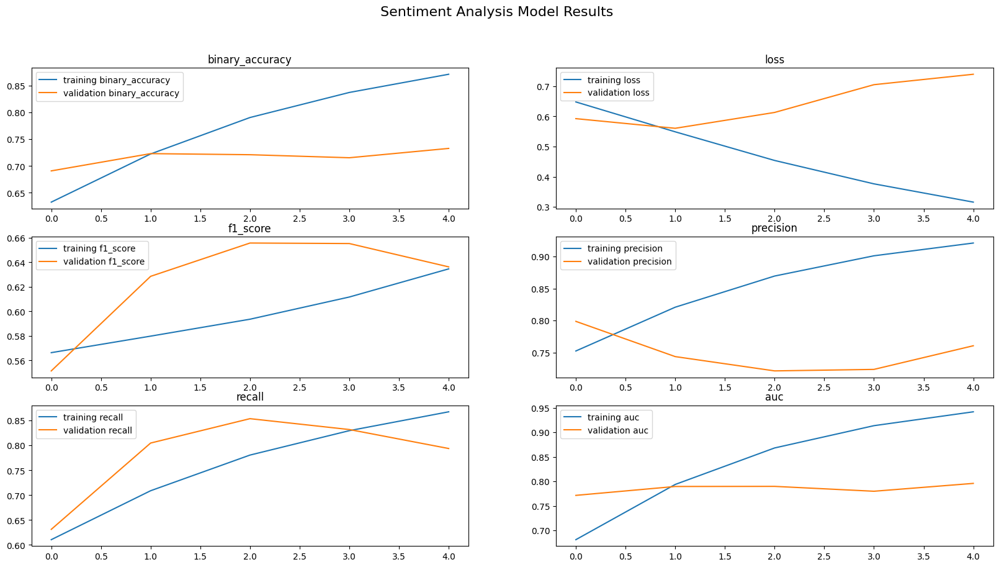

In [151]:
import re

metrics_stats = ["binary_accuracy", "loss", "f1_score", "precision", "recall", "auc"]
fig, ax = plt.subplots(3, 2, figsize=(20, 10))
ax = ax.flatten()
stats = {re.sub(r'_\d+', '', key): value for key, value in history_sarcasm.history.items()}
for i, metric in enumerate(metrics_stats):
    ax[i].plot(stats[metric], label='training ' + metric)
    ax[i].plot(stats['val_' + metric], label='validation ' + metric)
    ax[i].legend()
    ax[i].set_title(metric)
plt.suptitle("Sentiment Analysis Model Results", fontsize=16)

This refers to Figure 2 in the paper

# Sentiment Analysis

# Importing Data and Basic EDA

In [152]:
from datasets import load_dataset
from sklearn.model_selection import train_test_split

finsent_df = load_dataset("takala/financial_phrasebank", "sentences_50agree", trust_remote_code=True)

finsent_df = pd.DataFrame(finsent_df['train'])

train_sent, temp_sent = train_test_split(finsent_df, test_size=0.3, stratify=finsent_df['label'], random_state=42)
val_sent, test_sent = train_test_split(temp_sent, test_size=0.6, stratify=temp_sent['label'], random_state=42)

In [ ]:
# Exporting financial sentiment data to csv
# finsent_df.to_csv('finsent_df.csv', index=False)

In [157]:
train_sent['sentence'].str.len().describe(percentiles=[.5, .75, .9, .95, .99])

count    6784.000000
mean      133.654629
std        58.289450
min         8.000000
50%       126.000000
75%       172.000000
90%       217.000000
95%       241.000000
99%       286.170000
max       362.000000
Name: sentence, dtype: float64

This shows 95% of the sentences are at least 241 words long. This will be used as the input dimension of the Bi-LSTM model similar to the sarcasm detector

# Data Augmentation and Data Preprocessing

In [185]:
syn_aug = naw.SynonymAug(aug_src="wordnet")
to_aug = train_sent
augmented_sentence = to_aug.progress_apply(lambda x: syn_aug.augment(x['sentence'])[0] , axis=1)

train_sent_aug = pd.DataFrame({"sentence": augmented_sentence, 'label': to_aug['label']})
train_sent = pd.concat([train_sent, train_sent_aug], axis=0)

100%|██████████| 6784/6784 [00:17<00:00, 379.06it/s]


In [158]:
max_length = 240 # Covers at least 95% of the length of the sentences
stride = max_length / 2

stop_words = set(stopwords.words('english'))
tokenizer = BertTokenizer.from_pretrained("ProsusAI/finbert")

def preprocessed(df):
    """
    Preprocess the sentences for sentiment analysis by removing stopwords, punctuation and lemmatizing the words using WordNetLemmatizer and BertTokenizer
    """
    lemmatizer = WordNetLemmatizer()
    sentence_preprocessed = " ".join([word for word in df['sentence'].translate(str.maketrans('', '', string.punctuation)).split() if word.lower not in stop_words])
    sentence_preprocessed = " ".join([lemmatizer.lemmatize(word) for word in sentence_preprocessed.split()])
    return tokenizer(sentence_preprocessed, 
                     truncation=True, max_length=max_length, stride=stride, 
                     return_tensors='tf', padding='max_length', return_overflowing_tokens=False)


train_sent['preprocessed'] = train_sent.progress_apply(lambda x: preprocessed(x), axis=1)

val_sent['preprocessed'] = val_sent.progress_apply(lambda x: preprocessed(x), axis=1)

test_sent['preprocessed'] = test_sent.progress_apply(lambda x: preprocessed(x), axis=1)

c:\Users\ander\AppData\Local\Programs\Python\Python311\Lib\site-packages\huggingface_hub\file_download.py:795: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(
100%|██████████| 873/873 [00:00<00:00, 1594.02it/s]


# Calculating Class Weights

In [186]:
train_sent['label'] = train_sent['label'].astype(np.int64)
classes = np.unique(train_sent['label'])
sentiment_class_weights = dict(zip(classes, compute_class_weight("balanced", classes=classes, y=train_sent['label'])))
sentiment_class_weights

{0: 2.672970843183609, 1: 0.5611248966087676, 2: 1.1851851851851851}

C:\Users\ander\AppData\Local\Temp\ipykernel_40220\1282681677.py:1: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  sns.countplot(data=train_sent, x='label').set(xticklabels=['Bearish (0)', 'Neutral (1)', 'Bullish (2)'])


Text(0.5, 1.0, 'Number of bullish, bearish and neutral \nsentences in the training set')

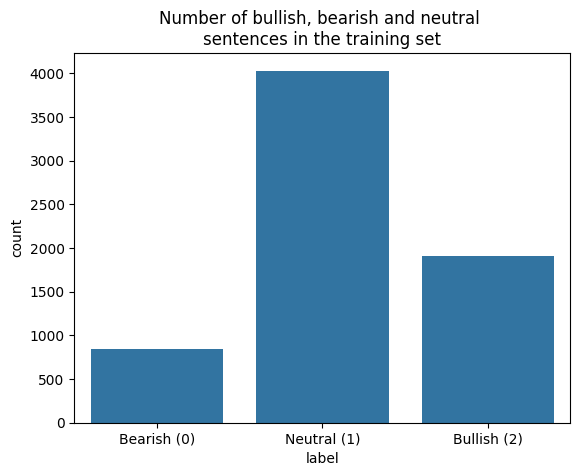

In [156]:
sns.countplot(data=train_sent, x='label').set(xticklabels=['Bearish (0)', 'Neutral (1)', 'Bullish (2)'])
plt.title("Number of bullish, bearish and neutral \nsentences in the training set")

This refers to Figure 3 in the paper

# Construction of Training, Validation and Test Sets

In [159]:
train_sent_dataset = tfDatasetCreation(train_sent[['preprocessed', 'label']], token_type_ids_flag=False, overflowing_token_flag=False)
val_sent_dataset = tfDatasetCreation(val_sent[['preprocessed', 'label']], token_type_ids_flag=False, overflowing_token_flag=False)
test_sent_dataset = tfDatasetCreation(test_sent[['preprocessed', 'label']], token_type_ids_flag=False, overflowing_token_flag=False)

In [160]:
batch_size = 32

train_sent_dataset = train_sent_dataset.shuffle(buffer_size=len(train_sent)).batch(batch_size).prefetch(buffer_size=tf.data.experimental.AUTOTUNE)
val_sent_dataset = val_sent_dataset.batch(batch_size).prefetch(buffer_size=tf.data.experimental.AUTOTUNE)
test_sent_dataset = test_sent_dataset.batch(batch_size).prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

# One-hot encode labels for sentiment analysis
train_sent_dataset = train_sent_dataset.map(lambda x, y: (x, tf.one_hot(tf.cast(y, tf.int32), depth=3)))
val_sent_dataset = val_sent_dataset.map(lambda x, y: (x, tf.one_hot(tf.cast(y, tf.int32), depth=3)))
test_sent_dataset = test_sent_dataset.map(lambda x, y: (x, tf.one_hot(tf.cast(y, tf.int32), depth=3)))

# Bi-LSTM Model for Sentiment Analysis

In [167]:
def BiLSTM_sentiment(max_length, tokenizer, optimizer=Adam(learning_rate=1e-3), num_classes=3, loss="sparse_categorical_crossentropy", metrics=["accuracy"]):
    """
    Bidirectional LSTM model for sentiment analysis
    - max_length: maximum length of the input sequence
    - optimizer: optimizer of model
    - num_classes: number of classes response variable has
    - tokenizer: BertTokenizer object
    - loss: loss function
    - metrics: evaluation metrics
    """
    input_ids = Input(shape=(max_length,), dtype=tf.int32, name='input_ids')
    attention_mask = Input(shape=(max_length,), dtype=tf.int32, name='attention_mask')

    embedding = Embedding(input_dim=tokenizer.vocab_size, output_dim=256)
    embedded_sequences = embedding(input_ids)

    lstm1 = Bidirectional(LSTM(128, return_sequences=True))(embedded_sequences)
    batch_norm1 = BatchNormalization()(lstm1)
    dropout1 = Dropout(0.5)(batch_norm1)

    lstm2 = Bidirectional(LSTM(128))(batch_norm1)
    batch_norm2 = BatchNormalization()(lstm2)
    dropout2 = Dropout(0.5)(batch_norm2)

    dense2 = Dense(num_classes, activation="softmax", kernel_regularizer=l2(0.01))(dropout2)

    model = Model(inputs=[input_ids, attention_mask], outputs=dense2)

    model.compile(optimizer=optimizer, loss=loss, metrics=metrics)

    model.summary()

    return model

# Model Training and Performance Analysis

In [168]:
epochs = 15

metrics = [
    tf.keras.metrics.CategoricalAccuracy(),
    tf.keras.metrics.F1Score(average="weighted"),
    tf.keras.metrics.Precision(),
    tf.keras.metrics.Recall(),
    tf.keras.metrics.AUC(),
]

sentiment_model = BiLSTM_sentiment(max_length, tokenizer, optimizer=Adam(learning_rate=1e-4), num_classes=3, loss="categorical_crossentropy", metrics=metrics)

early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

learning_rate_reduction = ReduceLROnPlateau(monitor='val_loss', patience=2, verbose=1, factor=0.3, min_lr=1e-6)

history_sentiment = sentiment_model.fit(train_sent_dataset, validation_data=val_sent_dataset, epochs=epochs, class_weight=sentiment_class_weights, callbacks=[early_stopping, learning_rate_reduction])

results_sentiment = sentiment_model.evaluate(test_sent_dataset)

Model: "functional_18"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_ids           │ (None, 240)       │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ embedding_18        │ (None, 240, 256)  │  7,813,632 │ input_ids[0][0]   │
│ (Embedding)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bidirectional_36    │ (None, 240, 256)  │    394,240 │ embedding_18[0][… │
│ (Bidirectional)     │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 240, 256)  │      1,024 │ bidirectional_36… │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bidirectional_37    │ (None, 256)       │    394,240 │ batch_normalizat… │
│ (Bidirectional)     │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 256)       │      1,024 │ bidirectional_37… │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_37          │ (None, 256)       │          0 │ batch_normalizat… │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ attention_mask      │ (None, 240)       │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_18 (Dense)    │ (None, 3)         │        771 │ dropout_37[0][0]  │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 8,604,931 (32.83 MB)

 Trainable params: 8,603,907 (32.82 MB)

 Non-trainable params: 1,024 (4.00 KB)

Epoch 1/15
212/212 ━━━━━━━━━━━━━━━━━━━━ 98s 433ms/step - auc_19: 0.5710 - categorical_accuracy: 0.3977 - f1_score: 0.4251 - loss: 1.3134 - precision_19: 0.4096 - recall_19: 0.2975 - val_auc_19: 0.3550 - val_categorical_accuracy: 0.1239 - val_f1_score: 0.0273 - val_loss: 1.3954 - val_precision_19: 0.1228 - val_recall_19: 0.1222 - learning_rate: 1.0000e-04
Epoch 2/15
212/212 ━━━━━━━━━━━━━━━━━━━━ 90s 426ms/step - auc_19: 0.7832 - categorical_accuracy: 0.6069 - f1_score: 0.6252 - loss: 0.8497 - precision_19: 0.6459 - recall_19: 0.5150 - val_auc_19: 0.4923 - val_categorical_accuracy: 0.1360 - val_f1_score: 0.0512 - val_loss: 1.4610 - val_precision_19: 0.1321 - val_recall_19: 0.1239 - learning_rate: 1.0000e-04
Epoch 3/15
212/212 ━━━━━━━━━━━━━━━━━━━━ 90s 427ms/step - auc_19: 0.9170 - categorical_accuracy: 0.7811 - f1_score: 0.7890 - loss: 0.4916 - precision_19: 0.8106 - recall_19: 0.7471 - val_auc_19: 0.8722 - val_categorical_accuracy: 0.7212 - val_f1_score: 0.7172 - val_loss: 0.7577 - val_pr

Text(0.5, 0.98, 'Sentiment Analysis Model Results')

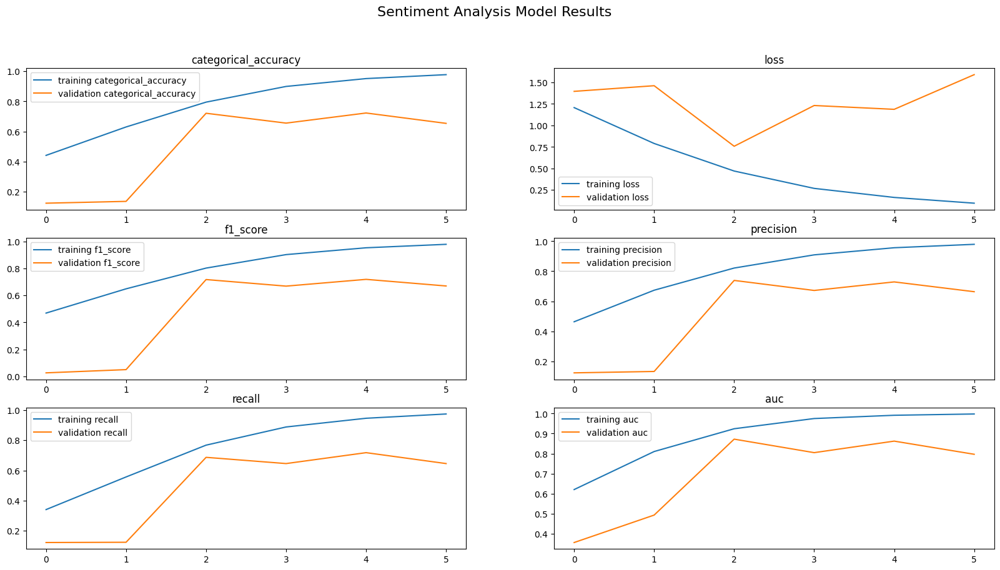

In [169]:
metrics_stats = ["categorical_accuracy", "loss", "f1_score", "precision", "recall", "auc"]
fig, ax = plt.subplots(3, 2, figsize=(20, 10))
ax = ax.flatten()
stats = {re.sub(r'_\d+', '', key): value for key, value in history_sentiment.history.items()}
for i, metric in enumerate(metrics_stats):
    ax[i].plot(stats[metric], label='training ' + metric)
    ax[i].plot(stats['val_' + metric], label='validation ' + metric)
    ax[i].legend()
    ax[i].set_title(metric)
plt.suptitle("Sentiment Analysis Model Results", fontsize=16)

This refers to Figure 4 in the paper